In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"
from IPython.display import display
import matplotlib.pyplot as plt
import plotly.offline as py
plt.style.use('default')
py.init_notebook_mode(connected=True)

In [2]:
import numpy as np
import pandas as pd
from BITS.utils import load_pickle, save_pickle
from BITS.plot import plot_scatter
from logzero import logger

In [3]:
import src.dalayout.graph as graph

In [4]:
overlaps = load_pickle("develop/dmel_middle/overlaps.pkl")

In [5]:
overlaps.head()

,read_i,read_j,strand,i_start_unit,i_end_unit,i_n_unit,j_start_unit,j_end_unit,j_n_unit,i_start_bp,...,i_len_bp,j_start_bp,j_end_bp,j_len_bp,overlap_len,overlap_type,mean_score,path,mean_score_second,overlap_len_second
0,152,206828,1,0,12,25,0,12,52,12,...,9485,87,4886,19102,4947,prefix-prefix,0.044702,"[[0, 39], [1, 40], [2, 41], [3, 42], [4, 43], ...",-0.000377,3804
1,152,239469,0,0,23,25,24,47,48,12,...,9485,9109,18085,18164,9566,contained,0.045736,"[[0, 24], [1, 25], [2, 26], [3, 27], [4, 28], ...",0.020102,9945
2,152,355191,0,0,14,25,10,24,25,12,...,9485,3858,9377,9377,5743,prefix-suffix,0.051195,"[[0, 10], [1, 11], [2, 12], [3, 13], [4, 14], ...",0.007008,2727
3,152,573269,0,1,24,25,0,23,29,393,...,9485,162,9161,11108,9549,contained,0.045736,"[[1, 0], [2, 1], [3, 2], [4, 3], [5, 4], [6, 5...",0.017251,2713
4,152,891390,1,0,15,25,0,15,28,12,...,9485,0,5887,10365,6105,prefix-prefix,0.054953,"[[0, 12], [1, 13], [2, 14], [3, 15], [4, 16], ...",-0.022642,3059


In [6]:
overlaps.shape[0]

66382

In [7]:
import plotly.offline as py
import plotly.graph_objs as go

def simple_hist(x, start=None, end=None, size=None):
    trace = go.Histogram(x=x)
    if start is not None:
        trace["xbins"]["start"] = start
    if end is not None:
        trace["xbins"]["end"] = end
    if size is not None:
        trace["xbins"]["size"] = size
    py.iplot(go.Figure(data=[trace]))

In [8]:
simple_hist(overlaps["mean_score"], size=0.0001)

In [9]:
simple_hist(overlaps["mean_score_second"], size=0.0001)

In [10]:
simple_hist(overlaps["mean_score"] - overlaps["mean_score_second"], size=0.0001)

In [11]:
overlaps[overlaps.apply(lambda df : df["mean_score"] - df["mean_score_second"] >= 0.23, axis=1)]

,read_i,read_j,strand,i_start_unit,i_end_unit,i_n_unit,j_start_unit,j_end_unit,j_n_unit,i_start_bp,...,i_len_bp,j_start_bp,j_end_bp,j_len_bp,overlap_len,overlap_type,mean_score,path,mean_score_second,overlap_len_second
9,219,540231,0,0,7,28,4,11,12,176,...,10673,1732,4570,4570,3054,prefix-suffix,0.066104,"[[0, 4], [1, 5], [2, 6], [3, 7], [4, 8], [5, 9...",-0.2,380
22,540,614556,0,7,42,43,0,35,59,2546,...,15910,23,13851,22589,13705,suffix-prefix,0.045023,"[[7, 0], [8, 1], [9, 2], [10, 3], [11, 4], [12...",-0.2,385
194,1485,120359,0,0,10,11,17,27,42,11,...,4224,6330,10303,15223,4052,contained,0.054573,"[[0, 17], [1, 18], [2, 19], [3, 20], [4, 21], ...",-0.2,392
195,1485,500637,0,0,10,11,5,15,18,11,...,4224,2016,6045,6780,4094,contained,0.060253,"[[0, 5], [1, 6], [2, 7], [3, 8], [4, 9], [5, 1...",-0.2,392
196,1485,695402,0,0,10,11,19,29,51,11,...,4224,6900,10909,18142,4061,contained,0.054775,"[[0, 19], [1, 20], [2, 21], [3, 22], [4, 23], ...",-0.2,392
198,1485,748058,0,0,10,11,7,17,35,11,...,4224,2433,6534,12531,4119,contained,0.069128,"[[0, 7], [1, 8], [2, 9], [3, 10], [4, 11], [5,...",-0.2,392
200,1485,952514,0,0,10,11,41,51,53,11,...,4224,15421,19377,19654,4044,contained,0.047057,"[[0, 41], [1, 42], [2, 43], [3, 44], [4, 45], ...",-0.2,392
201,1485,966357,0,0,10,11,7,17,42,11,...,4224,2668,6634,14890,4047,contained,0.041644,"[[0, 7], [1, 8], [2, 9], [3, 10], [4, 11], [5,...",-0.2,392
203,1485,1111755,1,0,10,11,14,24,30,11,...,4224,5196,9357,11044,4186,contained,0.055634,"[[0, 5], [1, 6], [2, 7], [3, 8], [4, 9], [5, 1...",-0.2,392
204,1485,1282225,1,0,10,11,10,20,52,11,...,4224,3469,7459,18443,4059,contained,0.066070,"[[0, 31], [1, 32], [2, 33], [3, 34], [4, 35], ...",-0.2,392


In [12]:
import igraph as ig

In [13]:
def remove_small_cc(sg, min_size=5):
    large_cc_vs = set()
    for g in sg.clusters(mode="weak").subgraphs():
        if g.vcount() >= 5:
            large_cc_vs.update(g.vs["name"])
    return ig.Graph.DictList(edges=(dict(source=e["source"],
                                             target=e["target"],
                                         length=e["length"],
                                         score=e["score"])
                                    for e in sg.es
                                    if e["source"] in large_cc_vs),
                             vertices=None,
                             directed=True)

In [14]:
def make_sg(overlaps, min_score=0.04, diff_score=0.02, max_second_score=0.01, min_overlap_len=3000, tr=True, plot=False, cover_rate=None):
    overlaps_filtered = overlaps[overlaps.apply(lambda df: df["mean_score"]  >= min_score
                                                and df["overlap_len"] >= min_overlap_len
                                                and df["mean_score"] - df["mean_score_second"] >= diff_score
                                                and df["mean_score_second"] < max_second_score, axis=1)]
    logger.info(f"{overlaps_filtered.shape[0]} out of {overlaps.shape[0]} overlaps remained")
    sg = graph.construct_string_graph(overlaps_filtered)
    logger.info(f"{len(sg.vs)} nodes and {len(sg.es)} edges in the string graph")
    sg = remove_small_cc(sg)
    logger.info(f"{len(sg.vs)} nodes and {len(sg.es)} edges after removing small CCs")
    if tr:
        sg = graph.transitive_reduction(sg)
        logger.info(f"{len(sg.vs)} nodes and {len(sg.es)} edges after transitive reduction")
    if not plot:
        return sg
    else:
        if cover_rate is None:
            logger.error("cover_rate must be specified")
        else:
            return (sg, graph.draw_graph(sg, cover_rate))

In [5]:
def find_overlaps(read_id):
    return overlaps[overlaps.apply(lambda df: df["read_i"] == read_id or df["read_j"] == read_id, axis=1)]

In [6]:
find_overlaps(85680)

,read_i,read_j,strand,i_start_unit,i_end_unit,i_n_unit,j_start_unit,j_end_unit,j_n_unit,i_start_bp,...,i_len_bp,j_start_bp,j_end_bp,j_len_bp,overlap_len,overlap_type,mean_score,path,mean_score_second,overlap_len_second
6331,36784,85680,0,15,32,33,0,18,67,5655,...,12575,26,7121,24254,7283,suffix-prefix,0.042595,"[[15, 0], [15, 1], [16, 2], [17, 3], [18, 4], ...",0.000000,379
12224,83845,85680,1,0,15,16,34,49,67,4,...,5867,12718,18736,24254,6046,contained,0.084524,"[[0, 17], [1, 18], [2, 19], [3, 20], [4, 21], ...",0.019433,6020
12388,85680,99254,0,45,54,67,0,9,10,16859,...,24254,180,3921,3921,3888,contains,0.045052,"[[45, 0], [46, 1], [47, 2], [48, 3], [49, 4], ...",0.038866,3870
12389,85680,147798,1,19,66,67,3,50,51,7121,...,24254,950,17911,17915,18336,suffix-suffix,0.041136,"[[19, 0], [20, 1], [21, 2], [22, 3], [23, 4], ...",0.009251,15533
12390,85680,162895,1,29,54,67,0,25,26,10860,...,24254,45,9723,9724,10295,contains,0.075713,"[[29, 0], [30, 1], [31, 2], [32, 3], [32, 4], ...",0.023454,9874
12391,85680,221101,0,28,66,67,0,37,70,10478,...,24254,1,13587,24943,15156,suffix-prefix,0.044968,"[[28, 0], [29, 1], [30, 2], [31, 3], [32, 4], ...",0.013751,21530
12392,85680,268574,1,0,38,67,0,39,56,26,...,24254,48,15417,21766,15323,prefix-prefix,0.059888,"[[0, 16], [1, 17], [2, 18], [3, 19], [4, 20], ...",0.000000,385
12393,85680,283204,1,7,41,67,0,34,35,2642,...,24254,78,13077,13225,13153,contains,0.075198,"[[7, 0], [8, 1], [9, 2], [10, 3], [11, 4], [12...",0.000000,372
12394,85680,290970,1,23,54,67,0,31,32,8619,...,24254,182,12206,12300,12126,contains,0.082433,"[[23, 0], [24, 1], [25, 2], [26, 3], [27, 4], ...",0.005248,4158
12395,85680,324008,1,23,66,67,24,64,65,8619,...,24254,8776,24740,24741,16488,suffix-suffix,0.042434,"[[23, 0], [24, 1], [25, 2], [26, 3], [27, 4], ...",0.008660,1866


In [16]:
cover_rate = pd.read_csv("develop/dmel_all/cover_rate", sep='\t', index_col=0)

In [78]:
ret = make_sg(overlaps, 0.06, 0, 1, 5000, plot=False, cover_rate=cover_rate)

[I 190227 11:55:47 <ipython-input-14-428cd2c41b63>:6] 6854 out of 66382 overlaps remained
[I 190227 11:55:48 <ipython-input-14-428cd2c41b63>:8] 4672 nodes and 6208 edges in the string graph
[I 190227 11:55:48 <ipython-input-14-428cd2c41b63>:10] 3698 nodes and 5630 edges after removing small CCs
[I 190227 11:56:11 <ipython-input-14-428cd2c41b63>:13] 3698 nodes and 4924 edges after transitive reduction


In [81]:
cc = [(g, g.vcount()) for g in ret.clusters(mode="weak").subgraphs() if g.vcount() >= 20]

In [82]:
cc

[(<igraph.Graph at 0x7f95a54445e8>, 77),
 (<igraph.Graph at 0x7f95a54448b8>, 77),
 (<igraph.Graph at 0x7f9596adc7c8>, 39),
 (<igraph.Graph at 0x7f958d860048>, 70),
 (<igraph.Graph at 0x7f958d860138>, 39),
 (<igraph.Graph at 0x7f958d860318>, 86),
 (<igraph.Graph at 0x7f958d860408>, 62),
 (<igraph.Graph at 0x7f958d860a98>, 213),
 (<igraph.Graph at 0x7f958d8608b8>, 20),
 (<igraph.Graph at 0x7f958d860b88>, 213),
 (<igraph.Graph at 0x7f958d860e58>, 70),
 (<igraph.Graph at 0x7f95a9a959a8>, 151),
 (<igraph.Graph at 0x7f95a9a958b8>, 40),
 (<igraph.Graph at 0x7f95a9a955e8>, 29),
 (<igraph.Graph at 0x7f95a9a95a98>, 26),
 (<igraph.Graph at 0x7f958ef2b048>, 32),
 (<igraph.Graph at 0x7f958ef2b6d8>, 36),
 (<igraph.Graph at 0x7f958ef2b8b8>, 62),
 (<igraph.Graph at 0x7f958ef2bd68>, 26),
 (<igraph.Graph at 0x7f958418b048>, 59),
 (<igraph.Graph at 0x7f958418b5e8>, 151),
 (<igraph.Graph at 0x7f958418b8b8>, 20),
 (<igraph.Graph at 0x7f958418bb88>, 86),
 (<igraph.Graph at 0x7f959c8ff048>, 59),
 (<igraph.Gr

In [83]:
for g, s in cc:
    graph.draw_graph(g, cover_rate, by="plotly")

In [113]:
ret = make_sg(overlaps, 0.04, 0.03, 1, 10000, plot=False, cover_rate=cover_rate)

[I 190227 12:26:22 <ipython-input-14-428cd2c41b63>:6] 5769 out of 66382 overlaps remained
[I 190227 12:26:22 <ipython-input-14-428cd2c41b63>:8] 3598 nodes and 5386 edges in the string graph
[I 190227 12:26:22 <ipython-input-14-428cd2c41b63>:10] 2828 nodes and 4916 edges after removing small CCs
[I 190227 12:26:39 <ipython-input-14-428cd2c41b63>:13] 2828 nodes and 3984 edges after transitive reduction


In [114]:
cc = [(g, g.vcount()) for g in ret.clusters(mode="weak").subgraphs() if g.vcount() >= 30]

In [115]:
cc

[(<igraph.Graph at 0x7f9445b2a138>, 46),
 (<igraph.Graph at 0x7f9446395e58>, 186),
 (<igraph.Graph at 0x7f9446395c78>, 41),
 (<igraph.Graph at 0x7f94463956d8>, 186),
 (<igraph.Graph at 0x7f9446395138>, 31),
 (<igraph.Graph at 0x7f944680eb88>, 53),
 (<igraph.Graph at 0x7f944680e9a8>, 53),
 (<igraph.Graph at 0x7f944680e228>, 38),
 (<igraph.Graph at 0x7f94473e9d68>, 38),
 (<igraph.Graph at 0x7f94473e9318>, 31),
 (<igraph.Graph at 0x7f9447a0d8b8>, 31),
 (<igraph.Graph at 0x7f94482e64f8>, 34),
 (<igraph.Graph at 0x7f94482e6318>, 41),
 (<igraph.Graph at 0x7f944885dd68>, 36),
 (<igraph.Graph at 0x7f944885d408>, 31),
 (<igraph.Graph at 0x7f9449060b88>, 37),
 (<igraph.Graph at 0x7f94490608b8>, 46),
 (<igraph.Graph at 0x7f94490604f8>, 37),
 (<igraph.Graph at 0x7f94496577c8>, 36),
 (<igraph.Graph at 0x7f9449657048>, 34)]

In [116]:
for g, s in cc:
    graph.draw_graph(g, cover_rate, by="plotly")

In [29]:
pos[sg.vs.find("221101:B").index]

[-10.125385972274769, -39.49592379208726]

In [22]:
find_overlaps(1132487)

,read_i,read_j,strand,i_start_unit,i_end_unit,i_n_unit,j_start_unit,j_end_unit,j_n_unit,i_start_bp,...,i_len_bp,j_start_bp,j_end_bp,j_len_bp,overlap_len,overlap_type,mean_score,path,mean_score_second,overlap_len_second
7026,46085,1132487,0,117,158,159,0,41,113,14165,...,19172,27,5181,14034,5215,suffix-prefix,0.052131,"[[117, 0], [118, 1], [119, 2], [120, 3], [120,...",0.021941,3761
11139,70211,1132487,1,0,28,29,1,29,113,18,...,3435,147,3714,14034,3512,contained,0.043669,"[[0, 83], [1, 84], [2, 85], [3, 86], [4, 87], ...",-0.007310,1104
12699,82252,1132487,1,0,29,52,0,29,113,14,...,6355,27,3714,14034,3670,prefix-prefix,0.084247,"[[0, 83], [1, 84], [2, 85], [3, 86], [4, 87], ...",0.049450,2196
12785,82868,1132487,0,103,155,156,0,52,113,12769,...,19316,27,6530,14034,6630,suffix-prefix,0.094281,"[[103, 0], [104, 1], [105, 2], [106, 3], [107,...",0.021413,14792
16073,108022,1132487,1,0,82,147,0,82,113,68,...,17526,27,10174,14034,10160,prefix-prefix,0.063757,"[[0, 30], [1, 31], [2, 32], [3, 33], [4, 34], ...",-0.200000,119
16141,108548,1132487,1,0,58,78,0,58,113,32,...,9432,27,7267,14034,7290,prefix-prefix,0.068166,"[[0, 54], [1, 55], [2, 56], [3, 57], [4, 58], ...",0.005281,10432
17162,118118,1132487,1,40,153,195,0,112,113,4793,...,23432,27,13951,14034,14285,contains,0.076852,"[[40, 0], [41, 1], [42, 2], [43, 3], [44, 4], ...",0.014695,15775
18479,134866,1132487,1,44,157,158,0,112,113,6003,...,19921,27,13951,14034,14328,contains,0.073174,"[[44, 0], [45, 1], [46, 2], [47, 3], [48, 4], ...",0.016238,14494
20058,152237,1132487,0,43,135,136,0,92,113,5724,...,17463,27,11422,14034,11714,suffix-prefix,0.059757,"[[43, 0], [44, 1], [45, 2], [46, 3], [47, 4], ...",-0.003096,1770
21516,160080,1132487,1,0,110,149,0,109,113,54,...,18212,27,13585,14034,13728,prefix-prefix,0.087334,"[[0, 3], [1, 4], [2, 5], [3, 6], [4, 7], [5, 8...",0.017328,12625


## HC

In [85]:
overlaps = load_pickle("develop/dmel_all/overlaps_hc.pkl")

In [86]:
overlaps.shape[0]

1432230

In [91]:
overlaps = overlaps[overlaps["mean_score"] >= 0.05]

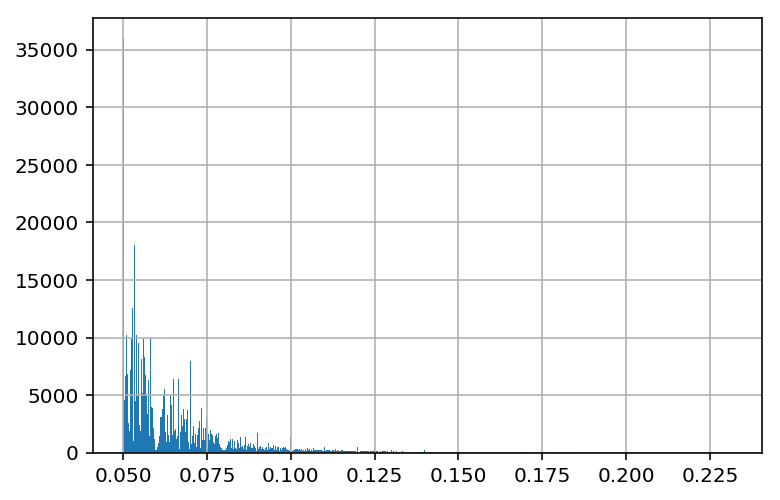

In [92]:
overlaps["mean_score"].hist(bins=1000)

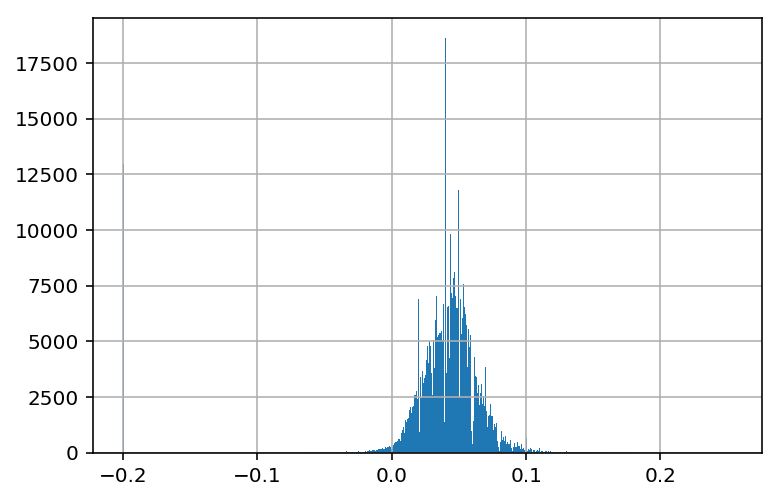

In [95]:
overlaps["mean_score_second"].hist(bins=1000)

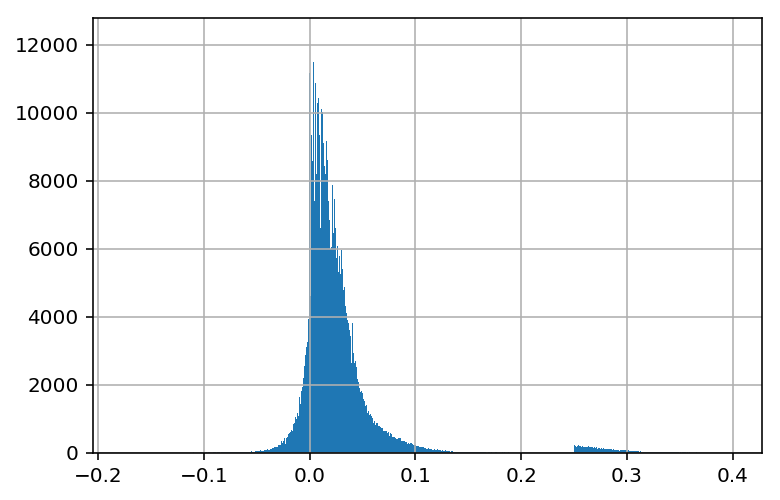

In [96]:
(overlaps["mean_score"] - overlaps["mean_score_second"]).hist(bins=1000)

In [107]:
ret = make_sg(overlaps, 0.1, 0.06, 0.02, 5000, plot=False, cover_rate=cover_rate)

[I 190227 12:10:47 <ipython-input-14-428cd2c41b63>:6] 4929 out of 682694 overlaps remained
[I 190227 12:10:47 <ipython-input-14-428cd2c41b63>:8] 3352 nodes and 5168 edges in the string graph
[I 190227 12:10:47 <ipython-input-14-428cd2c41b63>:10] 2500 nodes and 4682 edges after removing small CCs
[I 190227 12:11:03 <ipython-input-14-428cd2c41b63>:13] 2500 nodes and 4083 edges after transitive reduction


In [108]:
cc = [(g, g.vcount()) for g in ret.clusters(mode="weak").subgraphs() if g.vcount() >= 50]

In [109]:
cc

[(<igraph.Graph at 0x7f942197f7c8>, 73),
 (<igraph.Graph at 0x7f9422a39d68>, 109),
 (<igraph.Graph at 0x7f9422a399a8>, 148),
 (<igraph.Graph at 0x7f9422de4e58>, 157),
 (<igraph.Graph at 0x7f9422de48b8>, 52),
 (<igraph.Graph at 0x7f9422de45e8>, 90),
 (<igraph.Graph at 0x7f9422de4048>, 148),
 (<igraph.Graph at 0x7f9423ba1d68>, 151),
 (<igraph.Graph at 0x7f9423ba1b88>, 90),
 (<igraph.Graph at 0x7f9423ba1408>, 151),
 (<igraph.Graph at 0x7f9423ba1138>, 62),
 (<igraph.Graph at 0x7f9423e7ca98>, 109),
 (<igraph.Graph at 0x7f9423e7c6d8>, 62),
 (<igraph.Graph at 0x7f94243b24f8>, 73),
 (<igraph.Graph at 0x7f94247eec78>, 55),
 (<igraph.Graph at 0x7f94247eea98>, 52),
 (<igraph.Graph at 0x7f94247ee4f8>, 157),
 (<igraph.Graph at 0x7f942544dc78>, 55)]

In [110]:
for g, s in cc:
    graph.draw_graph(g, cover_rate, by="plotly")

## SVS viewer

In [19]:
o = load_pickle(f"develop/dmel_all/overlap_obj.pkl")

In [20]:
o.read_sigs[(272958, 0)]

[(1, 5, 0, 'boundary', nan, 41, 405, 364),
 (1,
  4,
  0,
  'complete',
  array([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0,
         0, 0, 0, 0, 1, 0, 0]),
  405,
  776,
  371),
 (1,
  5,
  0,
  'complete',
  array([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0,
         0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1,
         1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]),
  776,
  1141,
  365),
 (1,
  4,
  0,
  'complete',
  array([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0,
         0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
         0, 1, 0, 0, 1, 0, 0]),
  1138,
  1509,
  371),
 (1,
  4,
  0,
  'complete',
  array([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
         0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0,
         0, 0, 0, 0, 0, 0, 0]),
  

In [41]:
ret = o.svs_read_alignment(272958, 1148552, 0, plot=True)

In [42]:
ret

(0.0, [array([30,  0])], -0.2, [array([30,  0])])

In [13]:
ret = o.svs_read_alignment(720, 110011, 1, plot=True)

In [14]:
ret

(0.0428571428571429,
 [array([49,  0]),
  array([50,  1]),
  array([51,  2]),
  array([52,  3]),
  array([53,  4]),
  array([54,  5]),
  array([55,  6]),
  array([56,  7])],
 0.026190476190476247,
 [array([51,  0]),
  array([52,  1]),
  array([53,  2]),
  array([54,  3]),
  array([55,  4]),
  array([56,  5])])